# Car Price Estimation based on Carmax Listings
***Key Words:** Web Scraping, Regex, Random Forest*

**Icey Xue**  
03/15/2024

## Part 1: Web Scraping

In [3]:
from bs4 import BeautifulSoup
import requests
import time
import pandas as pd
import numpy as np
import re
import os

import json
import selenium
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from selenium.webdriver.common.by import By
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.common.exceptions import TimeoutException, ElementClickInterceptedException, NoSuchElementException
from selenium.webdriver.chrome.service import Service

headers = {'User-Agent': 'Mozilla/5.0'}

### Step 1: Carmax Listing Scraping
-- Load whole listing page and store page source.

In [ ]:
carmax_suv_url = "https://www.carmax.com/cars/all"

driver = webdriver.Chrome(service=Service('/Users/iceyxue/Desktop/Data Design & Representation/HW/Final Project/chromedriver'))
driver.get(carmax_suv_url)

wait = WebDriverWait(driver, 60)
i=1

while True:
    try:
        # Save temporary page source
        with open("source/temp/carmax_{}.htm".format(i), "w", encoding="utf-8") as f:
            f.write(driver.page_source)
        
        # Scroll to the "See More Products" button to ensure it's in view
        see_more_button_presense = wait.until(EC.presence_of_element_located((By.CSS_SELECTOR, "div#see-more hzn-button")))
        driver.execute_script("arguments[0].scrollIntoView(true);", see_more_button_presense)
        time.sleep(2)

        # Click the "See More Products" button
        see_more_button_clickable = wait.until(EC.element_to_be_clickable((By.CSS_SELECTOR, "div#see-more hzn-button")))
        driver.execute_script("arguments[0].click();", see_more_button_clickable)
        time.sleep(5) # Wait for the page to load more products

        i+=1

    except (TimeoutException, ElementClickInterceptedException) as e:
        print("No more 'See More Products' button to click or Error encountered:\n", e)
        break

# Save whole page source
with open("source/carmax_listing_all.htm", "w", encoding="utf-8") as f:
    f.write(driver.page_source)

driver.quit()

No more 'See More Products' button to click or Error encountered:
 Message: script timeout
  (Session info: chrome=122.0.6261.94)



### Step 2: Products Scraping
-- scrap every product's URL and extract product info

In [3]:
with open("source/carmax_listing_all.htm", encoding="utf-8") as f:
    whole_page = f.read()

whole_soup = BeautifulSoup(whole_page, 'html.parser')
print(whole_soup.prettify())

<html class="js-focus-visible" data-js-focus-visible="" lang="en" style="--vh: 10.23px; --vw: 1200px;">
 <head class="at-element-marker">
  <meta charset="utf-8"/>
  <meta content="width=device-width, initial-scale=1.0" name="viewport"/>
  <title>
   Used cars for Sale
  </title>
  <meta content="Used cars for Sale on carmax.com. Search used cars, research vehicle models, and compare cars, all online at carmax.com" name="description"/>
  <meta name="keywords"/>
  <link href="https://www.carmax.com/cars/all" rel="canonical"/>
  <meta content="index,follow" name="robots"/>
  <link href="//img2.carmax.com" rel="preconnect"/>
  <link href="//cdn.levelaccess.net" rel="preconnect"/>
  <link href="//googletagmanager.com" rel="preconnect"/>
  <link href="https://www.carmax.com" rel="preconnect"/>
  <link as="font" crossorigin="" href="https://www.carmax.com/shared/fonts/lato-v16-latin-regular.woff2" rel="preload" type="font/woff2"/>
  <link as="font" crossorigin="" href="https://www.carmax.com

In [4]:
product_links = whole_soup.select('a[href]')
product_url_list = []
for link in product_links:
    url = link.get('href')
    if re.match(r'^/car/\d{8}$', url):
        product_url_list.append(url)
    else:
        continue

df_product_url = pd.DataFrame(product_url_list, columns=['url']).drop_duplicates()
print("Numbers of products scraped: ", df_product_url['url'].nunique())
df_product_url.to_csv("source/carmax_product_urls.csv", index=False)
df_product_url

Numbers of products scraped:  2013


,url
0,/car/24985159
3,/car/23759388
6,/car/24452440
9,/car/25010925
12,/car/25305524
...,...
6231,/car/25052570
6234,/car/25051399
6237,/car/25124710
6240,/car/25125207


### Step 3: Scrap body type models

In [2]:
# Go to CarMax research page to scrap all body types
research_page_url = "https://www.carmax.com/research"

driver = webdriver.Chrome(
    service=Service('/Users/iceyxue/Desktop/Data Design & Representation/HW/Final Project/chromedriver')
)
driver.get(research_page_url)

# store all body type urls in list
type_url_elements = driver.find_elements(By.CSS_SELECTOR, "div.researchByTypeTab_linkItemGroupContainer__rXSVD.researchByTypeTab_desktop__61B_4 > a")
type_urls = [element.get_attribute('href') for element in type_url_elements]

driver.quit()

print(type_urls)
pd.DataFrame(type_urls).to_csv("source/type_models/type_urls.csv")

['https://www.carmax.com/research/suvs', 'https://www.carmax.com/research/trucks', 'https://www.carmax.com/research/sedans', 'https://www.carmax.com/research/coupes', 'https://www.carmax.com/research/hatchbacks', 'https://www.carmax.com/research/convertibles', 'https://www.carmax.com/research/minivans-vans', 'https://www.carmax.com/research/station-wagons', 'https://www.carmax.com/research#Fuel%20type', 'https://www.carmax.com/research/electric-vehicles', 'https://www.carmax.com/research/plug-in-hybrids', 'https://www.carmax.com/research/hybrids', 'https://www.carmax.com/research/diesel-engines', 'https://www.carmax.com/research#Lifestyle', 'https://www.carmax.com/research/most-reliable-cars', 'https://www.carmax.com/research/sports-cars', 'https://www.carmax.com/research/luxury-vehicles', 'https://www.carmax.com/research/suvs/3-rows', 'https://www.carmax.com/research/best-awd-cars', 'https://www.carmax.com/research#Body%20type']


In [ ]:
driver = webdriver.Chrome(
    service=Service('/Users/iceyxue/Desktop/Data Design & Representation/HW/Final Project/chromedriver')
)
wait = WebDriverWait(driver, 20)

# scrap every type page to get model lists
for url in type_urls:
    type_name = url.split("/")[-1][:-1]
    
    time.sleep(5)
    driver.get(url)

    # scroll the 'View All' button into view
    view_all_button_presense = wait.until(EC.presence_of_element_located((By.CSS_SELECTOR, "#VIEW-ALL-AVAILABLE-MODELS-info-section")))
    driver.execute_script("arguments[0].scrollIntoView(true);", view_all_button_presense)

    # click the 'View All' button to show full model list
    view_all_button_clickable = wait.until(EC.element_to_be_clickable((By.CSS_SELECTOR, "#VIEW-ALL-AVAILABLE-MODELS-info-section")))
    driver.execute_script("arguments[0].click();", view_all_button_clickable)
    
    # locate the model list zone and read as soup
    all_models_zone = driver.find_element(By.CSS_SELECTOR, "#VIEW-ALL-AVAILABLE-MODELS-description")
    all_models_html = all_models_zone.get_attribute('outerHTML')
    all_models_soup = BeautifulSoup(all_models_html, 'html.parser')

    # store the sub-type and models in dict
    type_models_dict = {}

    # find all sub-type cards
    category_cards = all_models_soup.find_all("div", class_="researchByMmyCategories_card__eN0rb")

    for card in category_cards:
        # sub-type name is in a <p> tag with a specific class
        category_name = card.find("p", class_="researchByMmyCategories_title__8ad6A").text.strip()
        # find all <a> tags within <li> elements for the items in the sub-type
        item_links = card.find_all("a", class_="kmx-list-item-link")
        items = [link.text.strip() for link in item_links]
        # assign the list of models to the sub-type name in the dict
        type_models_dict[category_name] = items
    
    # save dict into json file
    with open("source/type_models/{}.json".format(type_name), 'w') as f:
        json.dump(type_models_dict, f, indent=4)

driver.quit()

### Step 4: Scrap features sof each product

In [54]:
df_product_url = pd.read_csv("source/carmax_product_urls.csv")
product_url_list = df_product_url['url']
carmax_url = "https://www.carmax.com"
driver = webdriver.Chrome(service=Service('/Users/iceyxue/Desktop/Data Design & Representation/HW/Final Project/chromedriver'))

product_dict = []

for url in product_url_list:

    full_url = carmax_url + url
    time.sleep(2)
    
    driver.get(full_url)

    title = driver.find_element(By.CSS_SELECTOR, "#car-header-basic-car-info").text
    price = driver.find_element(By.CSS_SELECTOR, "#header-section-sub-header > span.car-header-price").text
    mileage = driver.find_element(By.CSS_SELECTOR, "#header-section-sub-header > span.car-header-mileage").text

    # wait for the highlights sector to load
    try:
        WebDriverWait(driver, 60).until(
            EC.presence_of_element_located((By.CSS_SELECTOR, "#highlight-badges > div > div.tombstone-badge"))
        )
        highlight_elements = driver.find_elements(By.CSS_SELECTOR, "#highlight-badges > div > div.tombstone-badge")
        highlight = [element.text for element in highlight_elements]
    except TimeoutException: 
        highlight = None

    overview_elements = driver.find_elements(By.CSS_SELECTOR, "#car-page-tombstone-section > div.tombstone-badge")
    overview = [element.text.split("\n")[0] for element in overview_elements]

    dict = {
        'id': url[5:],
        'title': title,
        'price': price,
        'mileage': mileage,
        #'score': score, # unable to scrap score due to too long loading time
        'highlight': None if highlight == None else ' | '.join(highlight),
        'overview': ' | '.join(overview),
    }
    product_dict.append(dict)

driver.quit()

products_info = pd.DataFrame(product_dict)
products_info.to_csv("source/carmax_product_info.csv", index=False)

### Step 5: Data cleaning & Uniform format

In [67]:
products_info = pd.read_csv("source/carmax_product_info.csv")
products_info['id'] = products_info['id'].astype(int)
products_info['highlight'] = products_info['highlight'].fillna('NA')
products_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1926 entries, 0 to 1925
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         1926 non-null   int64 
 1   title      1926 non-null   object
 2   price      1926 non-null   object
 3   mileage    1926 non-null   object
 4   highlight  1926 non-null   object
 5   overview   1926 non-null   object
dtypes: int64(1), object(5)
memory usage: 90.4+ KB


In [68]:
products_info

,id,title,price,mileage,highlight,overview
0,25305524,2013 Chevrolet Volt,"$11,998*",103K miles,New Pair of Tires\nReplaced 2 tires to meet ou...,"35 city/40 hwy | 4-cyl, Plug-in Hybrid, 1.4L |..."
1,24999095,2019 BMW X1 SDrive28i,"$23,998*",33K miles,New Pair of Tires\nReplaced 2 tires to meet ou...,"23 city/32 hwy | 4-cyl, Turbo Gas, 2.0L | Fron..."
2,24283633,2014 Ford Fusion Energi SE,Price unavailable*,101K miles,New Pair of Tires\nReplaced 2 tires to meet ou...,"40 city/36 hwy | 4-cyl, Plug-in Hybrid, 2.0L |..."
3,24999948,2014 Volkswagen Jetta S,"$12,998*",74K miles,"Low Miles Per Year\nLess than 9,000 miles per ...","23 city/29 hwy | 4-cyl, Gas, 2.0L | Front Whee..."
4,24914826,2014 Chevrolet Sonic LT,"$11,599*",76K miles,Single Owner\nReported by AutoCheck® View Hist...,"27 city/37 hwy | 4-cyl, Turbo Gas, 1.4L | Fron..."
...,...,...,...,...,...,...
1921,25052570,2018 Mazda CX-9 Touring,"$23,998*",58K miles,NA,"22 city/28 hwy | 4-cyl, Turbo Gas, 2.5L | Fron..."
1922,25051399,2013 Toyota Prius Three,"$14,599*",93K miles,NA,"51 city/48 hwy | 4-cyl, Hybrid, 1.8L | Front W..."
1923,25124710,2017 Jeep Patriot Latitude,"$14,599*",97K miles,NA,"20 city/25 hwy | 4-cyl, Gas, 2.4L | Four Wheel..."
1924,25125207,2016 Ford Fusion SE,"$12,599*",128K miles,NA,"22 city/34 hwy | 4-cyl, Gas, 2.5L | Front Whee..."


In [69]:
products_data = products_info.copy()
products_data[['year','make','model','model_spec']] = products_data['title'].str.split(' ', n=3, expand=True)
products_data['price'] = products_data['price'].apply(lambda x: int(x[1:-1].replace(",", "")) if int(x.startswith("$")) else None)
products_data['mileage'] = products_data['mileage'].apply(lambda x: x.split()[0][:-1])

# split the overview column into features
# 1. define patterns for different features
#   (features' dictionary see file: feature_dict.pdf)
overview_patterns = {
    'fuel_eff_city': r'(\d+)\s*city',
    'fuel_eff_hwy': r'(\d+)\s*hwy',
    'cylinder': r'(\d+)-cyl',
    'fuel_type': r'(\bDiesel\b|\bElectric\b|\bGas\b|\bHybrid\b|\bPlug-In Hybrid\b)',
    'tank_volume': r'(\d+\.\d+)L',
    'drivetrain': r'(All|Four|Front|Rear) Wheel Drive',
    'color_ex': r'\b([A-Z][a-z]+)/[A-Z][a-z]+\b',
    'color_in': r'\b[A-Z][a-z]+/([A-Z][a-z]+\b)'
}

# 2. extract features based on pattern
for feature, pattern in overview_patterns.items():
    products_data[feature] = products_data['overview'].apply(lambda x: re.search(pattern, x).group(1) if re.search(pattern, x) else None)

feature_tier_pattern = r'(The Basics|Well-Equipped|Loaded)'
products_data['feature_tier'] = products_data['highlight'].apply(lambda x: re.search(feature_tier_pattern, x).group() if re.search(feature_tier_pattern, x) else None)

products_data = products_data.drop(columns=['title','highlight','overview'], axis=1)
products_data

,id,price,mileage,year,make,model,model_spec,fuel_eff_city,fuel_eff_hwy,cylinder,fuel_type,tank_volume,drivetrain,color_ex,color_in,feature_tier
0,25305524,11998.0,103,2013,Chevrolet,Volt,None,35,40,4,Hybrid,1.4,Front,Red,Black,Loaded
1,24999095,23998.0,33,2019,BMW,X1,SDrive28i,23,32,4,Gas,2.0,Front,Black,Black,Well-Equipped
2,24283633,NaN,101,2014,Ford,Fusion,Energi SE,40,36,4,Hybrid,2.0,Front,White,Cream,Well-Equipped
3,24999948,12998.0,74,2014,Volkswagen,Jetta,S,23,29,4,Gas,2.0,Front,White,Black,The Basics
4,24914826,11599.0,76,2014,Chevrolet,Sonic,LT,27,37,4,Gas,1.4,Front,Black,Black,Well-Equipped
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1921,25052570,23998.0,58,2018,Mazda,CX-9,Touring,22,28,4,Gas,2.5,Front,Black,Black,None
1922,25051399,14599.0,93,2013,Toyota,Prius,Three,51,48,4,Hybrid,1.8,Front,Black,Gray,None
1923,25124710,14599.0,97,2017,Jeep,Patriot,Latitude,20,25,4,Gas,2.4,Four,Silver,Gray,None
1924,25125207,12599.0,128,2016,Ford,Fusion,SE,22,34,4,Gas,2.5,Front,Black,Black,None


In [1]:
# change data type (auto done by read_csv)
#products_data.to_csv("source/products_data.csv", index=False)
products_data = pd.read_csv("products_data.csv")
products_data.info()

NameError: name 'products_data' is not defined

### Step 6: Combine extracted info with type using model

In [11]:
# combine all type_models json file into 1 dataframe
dataframes = []

# loop through all json files of type_models
for filename in os.listdir("source/type_models"):
    if filename.endswith('.json'):
        # Construct the full file path
        file_path = os.path.join("source/type_models", filename)
        # Read the JSON file
        with open(file_path, 'r') as file:
            data = json.load(file)
            # Create a DataFrame from the JSON data
            flat_data = [(k, v) for k, values in data.items() for v in values]
            df = pd.DataFrame(flat_data, columns=['body_subtype', 'make_model'])
            # Add a source identifier to the DataFrame
            df['body_type'] = filename.replace('.json', '')
            # Append the DataFrame to the list
            dataframes.append(df)

# Combine all DataFrames into one
type_models_df = pd.concat(dataframes, ignore_index=True)
type_models_df.to_csv("source/type_models/all_type_models.csv", index=False)

In [71]:
products_data_new = products_data.copy()
products_data_new['make_model'] = products_data_new['make'] + " " + products_data_new['model']

products_data_new = pd.merge(products_data_new, type_models_df, on='make_model', how='left')
products_data_new = products_data_new.drop(['make_model'], axis=1)
products_data_new

,id,price,mileage,year,make,model,model_spec,fuel_eff_city,fuel_eff_hwy,cylinder,fuel_type,tank_volume,drivetrain,color_ex,color_in,feature_tier,body_subtype,body_type
0,25305524,11998.0,103,2013,Chevrolet,Volt,NaN,35.0,40.0,4.0,Hybrid,1.4,Front,Red,Black,Loaded,NaN,NaN
1,24999095,23998.0,33,2019,BMW,X1,SDrive28i,23.0,32.0,4.0,Gas,2.0,Front,Black,Black,Well-Equipped,Subcompact,suv
2,24283633,NaN,101,2014,Ford,Fusion,Energi SE,40.0,36.0,4.0,Hybrid,2.0,Front,White,Cream,Well-Equipped,Mid-size,sedan
3,24999948,12998.0,74,2014,Volkswagen,Jetta,S,23.0,29.0,4.0,Gas,2.0,Front,White,Black,The Basics,Compact,sedan
4,24914826,11599.0,76,2014,Chevrolet,Sonic,LT,27.0,37.0,4.0,Gas,1.4,Front,Black,Black,Well-Equipped,Compact,sedan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2342,25052570,23998.0,58,2018,Mazda,CX-9,Touring,22.0,28.0,4.0,Gas,2.5,Front,Black,Black,NaN,Mid-size 7-passenger,suv
2343,25051399,14599.0,93,2013,Toyota,Prius,Three,51.0,48.0,4.0,Hybrid,1.8,Front,Black,Gray,NaN,NaN,NaN
2344,25124710,14599.0,97,2017,Jeep,Patriot,Latitude,20.0,25.0,4.0,Gas,2.4,Four,Silver,Gray,NaN,Compact,suv
2345,25125207,12599.0,128,2016,Ford,Fusion,SE,22.0,34.0,4.0,Gas,2.5,Front,Black,Black,NaN,Mid-size,sedan


### Step 7: Store data as CSV

In [ ]:
products_data_new.to_csv("carmax_data.csv", index=False)

# Part 2: Price Prediction with ML Models

## 1  Data Preparation

In [4]:
data = pd.read_csv("carmax_data.csv")
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2347 entries, 0 to 2346
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             2347 non-null   int64  
 1   price          1529 non-null   float64
 2   mileage        2347 non-null   int64  
 3   year           2347 non-null   int64  
 4   make           2347 non-null   object 
 5   model          2347 non-null   object 
 6   model_spec     2191 non-null   object 
 7   fuel_eff_city  1879 non-null   float64
 8   fuel_eff_hwy   1870 non-null   float64
 9   cylinder       2290 non-null   float64
 10  fuel_type      2326 non-null   object 
 11  tank_volume    2290 non-null   float64
 12  drivetrain     2246 non-null   object 
 13  color_ex       2345 non-null   object 
 14  color_in       2345 non-null   object 
 15  feature_tier   261 non-null    object 
 16  body_subtype   2088 non-null   object 
 17  body_type      2088 non-null   object 
dtypes: float

In [5]:
# Drop null price data
data = data.dropna(subset=['price'])
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1529 entries, 0 to 2346
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             1529 non-null   int64  
 1   price          1529 non-null   float64
 2   mileage        1529 non-null   int64  
 3   year           1529 non-null   int64  
 4   make           1529 non-null   object 
 5   model          1529 non-null   object 
 6   model_spec     1438 non-null   object 
 7   fuel_eff_city  1215 non-null   float64
 8   fuel_eff_hwy   1210 non-null   float64
 9   cylinder       1495 non-null   float64
 10  fuel_type      1518 non-null   object 
 11  tank_volume    1495 non-null   float64
 12  drivetrain     1458 non-null   object 
 13  color_ex       1528 non-null   object 
 14  color_in       1528 non-null   object 
 15  feature_tier   182 non-null    object 
 16  body_subtype   1367 non-null   object 
 17  body_type      1367 non-null   object 
dtypes: float64(5)

## 2  Data Visualizaton

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

#### 1) Categorical Variables: ['make','cylinder','fuel_type','drivetrain','feature_tier','body_type']

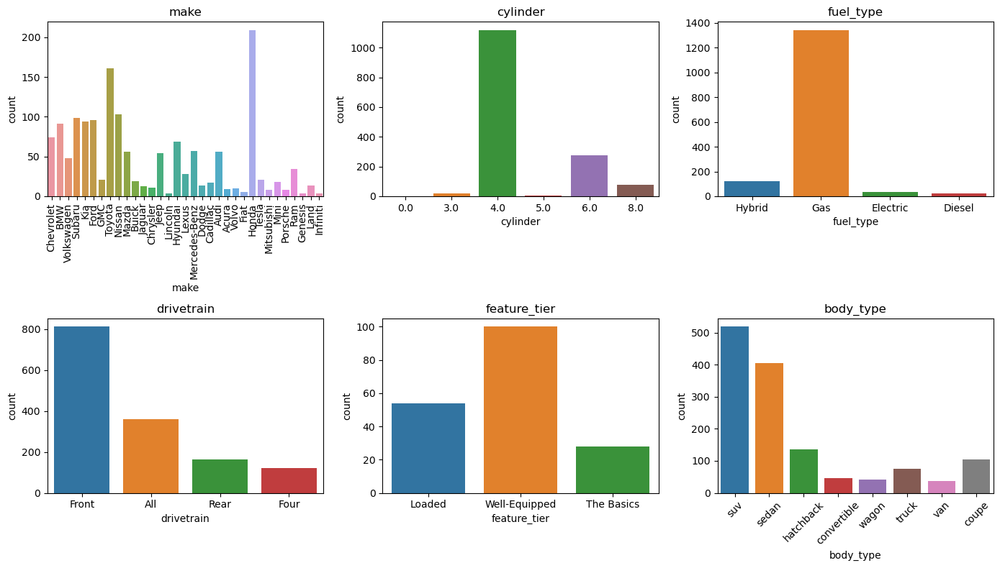

In [7]:
categorical_vars = ['make','cylinder','fuel_type','drivetrain','feature_tier','body_type']

fig, axes = plt.subplots(2, 3, figsize=(14, 8), sharey=False)
for i, col in enumerate(categorical_vars):
    row, col_index = divmod(i, 3)
    sns.countplot(x=col, data=data, ax=axes[row, col_index])
    axes[row, col_index].set_title(col)
axes[0,0].tick_params(axis='x', rotation=90)
axes[1,2].tick_params(axis='x', rotation=45)
plt.tight_layout()
plt.show()

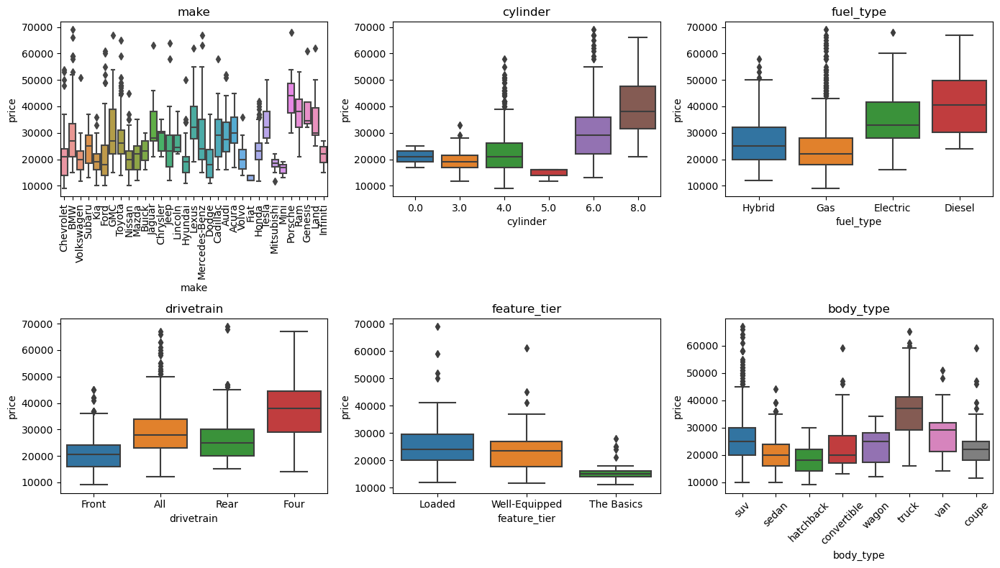

In [8]:
fig, axes = plt.subplots(2, 3, figsize=(14, 8), sharey=False)
for i, col in enumerate(categorical_vars):
    row, col_index = divmod(i, 3)
    sns.boxplot(x=col, y='price', data=data, ax=axes[row, col_index])
    axes[row, col_index].set_title(col)
axes[0,0].tick_params(axis='x', rotation=90)
axes[1,2].tick_params(axis='x', rotation=45)
plt.tight_layout()
plt.show()

#### 2) Numerical Variables: ['year','mileage','fuel_eff_city','fuel_eff_hwy','tank_volume']

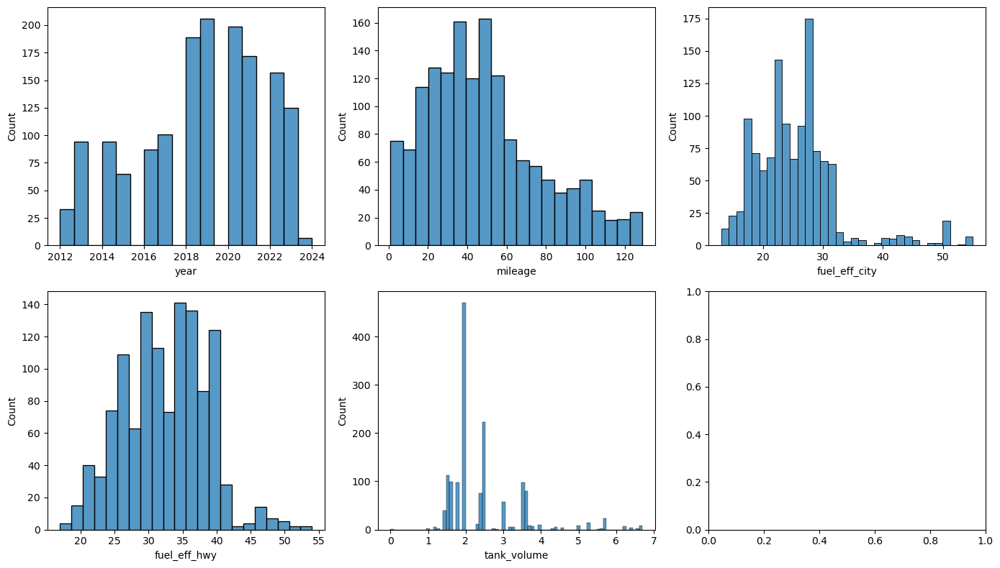

In [9]:
numerical_vars = ['year','mileage','fuel_eff_city','fuel_eff_hwy','tank_volume']

fig, axes = plt.subplots(2, 3, figsize=(14, 8), sharey=False)
for i, col in enumerate(numerical_vars):
    row, col_index = divmod(i, 3)
    sns.histplot(data[col], ax=axes[row, col_index])
plt.tight_layout()
plt.show()

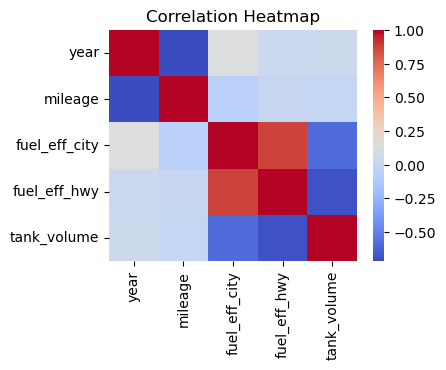

In [15]:
corr_coef = data[numerical_vars].corr()

plt.figure(figsize=(4, 3))
sns.heatmap(corr_coef, annot=False, fmt=".2f", cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

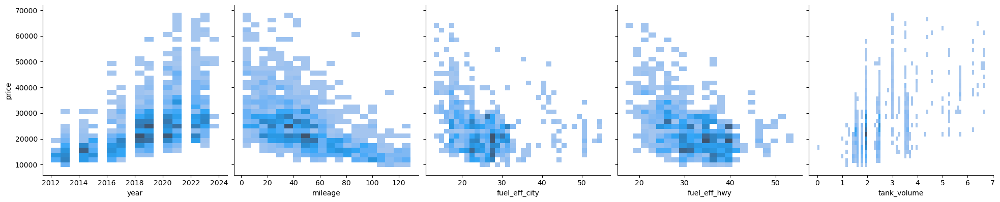

In [10]:
sns.pairplot(data,
             y_vars='price', 
             x_vars=numerical_vars, 
             height=4, aspect=1, kind='hist')
plt.show()

### 3  *Base Model: Linear Regression

### 4  Random Forest